In [35]:
from datetime import datetime, timedelta
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import utils
from matplotlib.gridspec import GridSpec

In [36]:
import importlib
import utils

importlib.reload(utils)

<module 'utils' from 'c:\\Users\\agand\\OneDrive\\Escritorio\\lakes\\lake-algae-analysis\\notebooks\\utils.py'>

In [37]:
config = utils.get_config()

ndwi = utils.get_image_from_lake(8421510, 'water', datetime(2020, 6, 13))
true = utils.get_image_from_lake(8421510, 'true', datetime(2020, 6, 23))
cloud = utils.get_image_from_lake(8421510, 'cloud', datetime(2020, 6, 23))
chl = utils.get_image_from_lake(8421510, 'chl', datetime(2020, 6, 23))

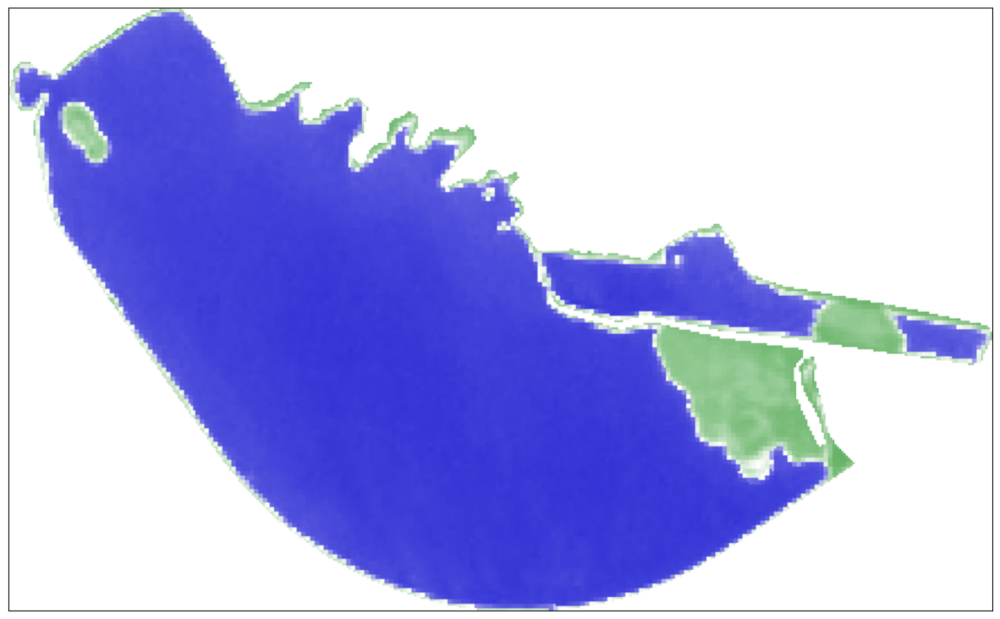

In [3]:
utils.plot_image(ndwi)

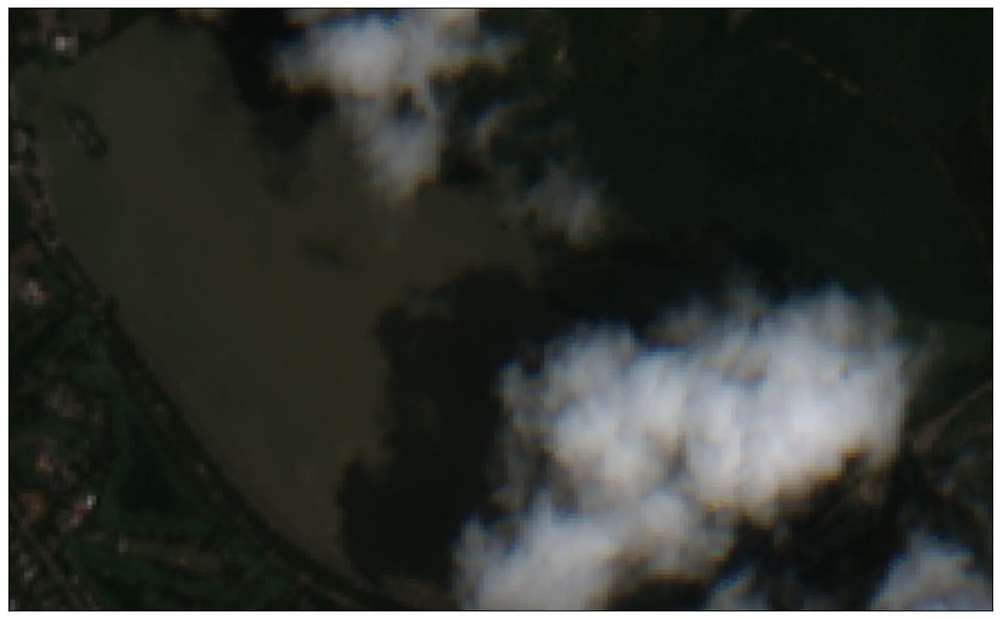

In [4]:
utils.plot_image(true)

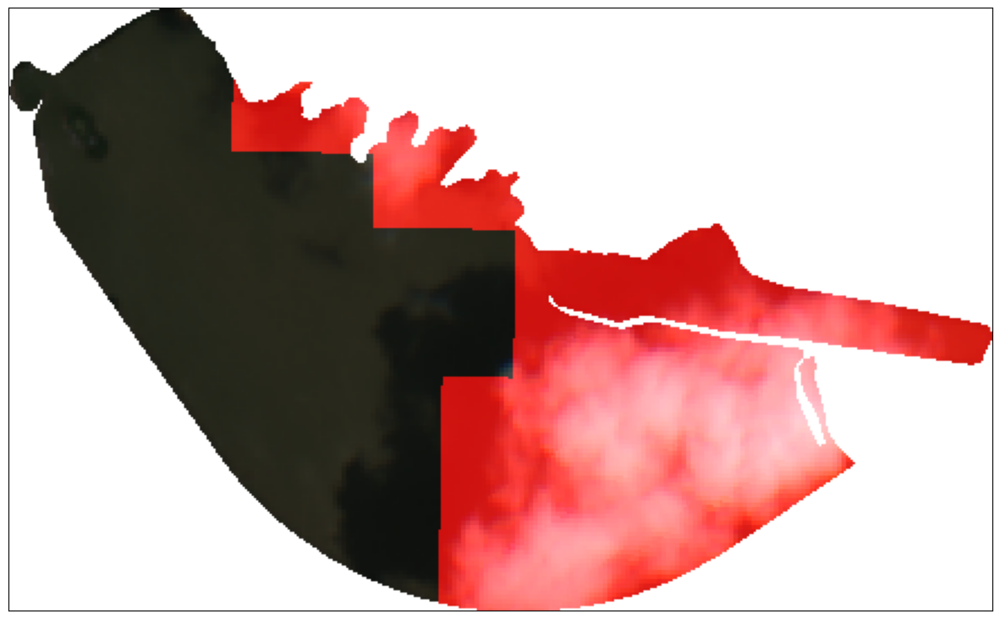

In [5]:
utils.plot_image(cloud)

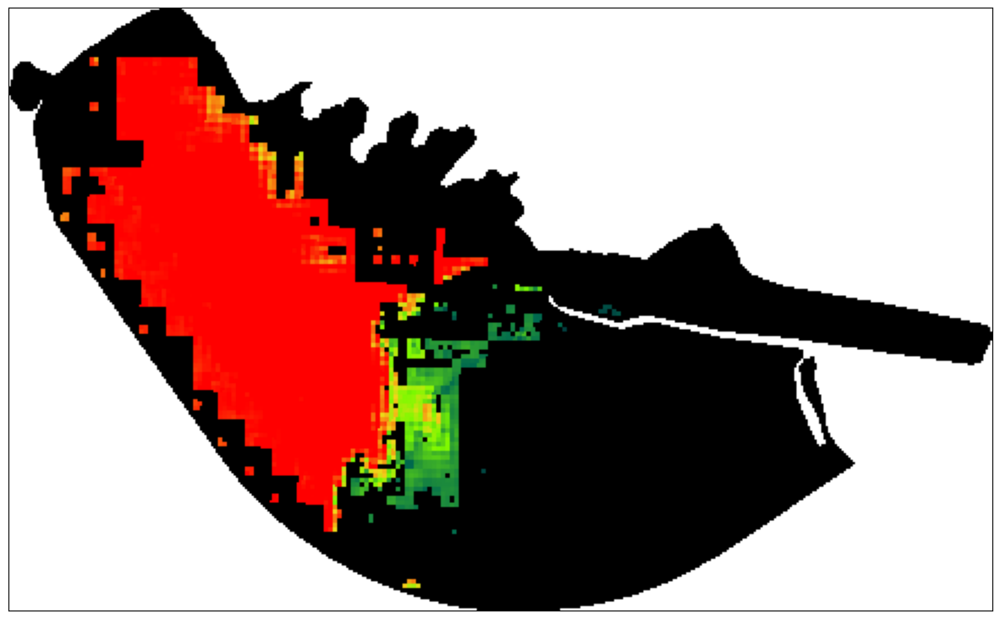

In [6]:
utils.plot_image(chl)

### True

In [30]:
def analyze_true_image(image):
    if np.all(image == 255):
        return False
    return True




### Water

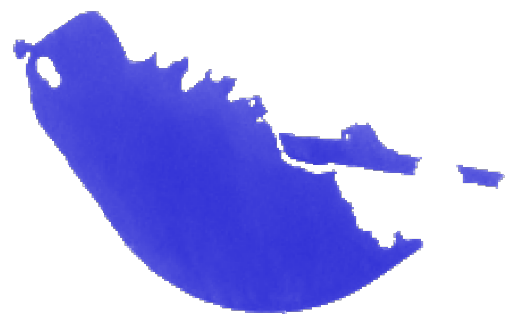

In [8]:
blue_pixels_mask = (ndwi[:, :, 2] > ndwi[:, :, 0]) & (ndwi[:, :, 2] > ndwi[:, :, 1]) & (ndwi[:, :, 3] != 0)
blue_pixels_count = np.sum(blue_pixels_mask)

blue_image = np.zeros_like(ndwi)

# Count blue pixels
blue_pixels_count = np.sum(blue_pixels_mask)

# Apply the mask to keep only blue pixels
blue_image[blue_pixels_mask] = ndwi[blue_pixels_mask]

# Convert the result back to an image and save or display it
plt.figure()
plt.imshow(blue_image)
plt.axis('off')
plt.show()

In [9]:
def analyze_water_image(image):
    blue_pixels_mask = (image[:, :, 2] > image[:, :, 0]) & (image[:, :, 2] > image[:, :, 1]) & (image[:, :, 3] != 0)
    blue_pixels_count = np.sum(blue_pixels_mask)
    return blue_pixels_count

In [10]:
print(analyze_water_image(ndwi))

49025


In [11]:
blue_pixels_count

49025

### Cloud

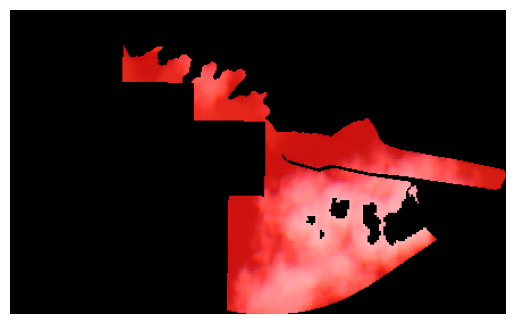

25807


In [12]:
import matplotlib.pyplot as plt 
red_threshold = 180
red_pixels_mask = (cloud[:, :, 0] > red_threshold) & (cloud[:, :, 1] < red_threshold) & (cloud[:, :, 2] < red_threshold)
red_region = np.zeros_like(cloud)
red_region[red_pixels_mask] = cloud[red_pixels_mask]

plt.figure()
plt.imshow(red_region)
plt.axis('off')
plt.show()

red_pixels_count = np.sum(red_pixels_mask)
print(red_pixels_count)

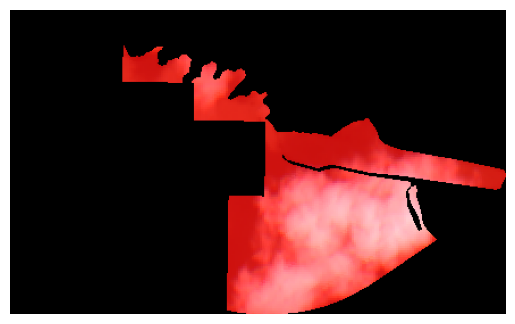

27338


In [23]:
red_pixels_mask2 = (cloud[:, :, 0] > cloud[:, :, 1]) & (cloud[:, :, 0] > cloud[:, :, 2]) & (cloud[:, :, 0]>190)
red_region2 = np.zeros_like(cloud)
red_region2[red_pixels_mask2] = cloud[red_pixels_mask2]

plt.figure()
plt.imshow(red_region2)
plt.axis('off')
plt.show()

red_pixels_count2 = np.sum(red_pixels_mask2)
print(red_pixels_count2)

# black_pixels_mask = np.all(cloud[:, :, :3] == [0, 0, 0], axis=-1) & (cloud[:, :, 3] != 0)

# # Define non-black pixels mask
# non_black_pixels_mask = ~black_pixels_mask

# non_black_pixels = cloud[non_black_pixels_mask]


In [121]:
def analyze_cloud_image(image):
    red_pixels_mask = (image[:, :, 0] > image[:, :, 1]) & (image[:, :, 0] > image[:, :, 2]) & (image[:, :, 0]>190)
    red_pixels_count = np.sum(red_pixels_mask)
    return red_pixels_count

In [16]:
red_region2

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)

### CHL

In [82]:
import importlib
import utils

importlib.reload(utils)

<module 'utils' from 'c:\\Users\\agand\\OneDrive\\Escritorio\\lakes\\lake-algae-analysis\\notebooks\\utils.py'>

In [71]:
chl2 = utils.get_image_from_lake(8421510, 'chl', datetime(2020, 4, 4), config)

../data/8421510/8421510_chlorophyll_2020-04-04.npy
loading image


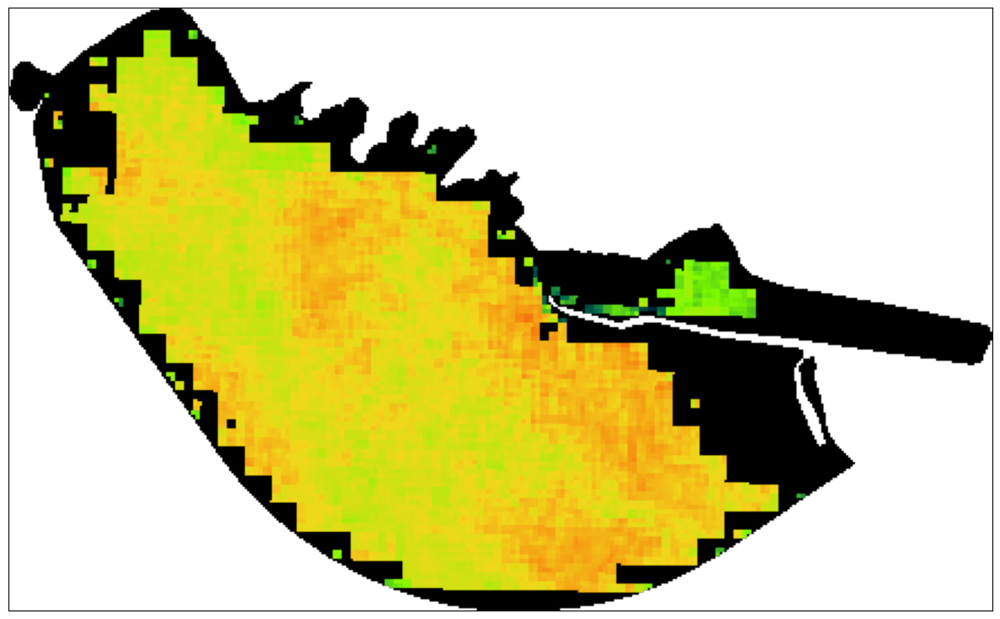

In [15]:
utils.plot_image(chl2)

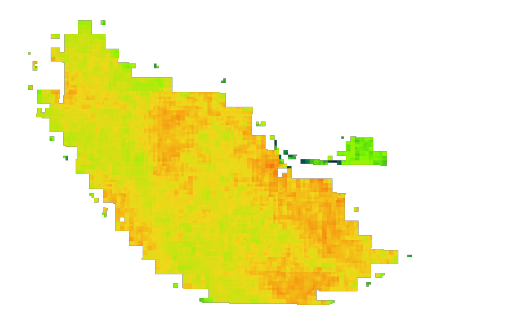

In [16]:
white_pixels_mask = np.all(chl2[:, :, :3] == [255, 255, 255], axis=-1)
black_pixels_mask = np.all(chl2[:, :, :3] == [0, 0, 0], axis=-1)

non_black_or_white_mask = ~white_pixels_mask & ~black_pixels_mask


chl_region = np.zeros_like(chl2)
chl_region[non_black_or_white_mask] = chl2[non_black_or_white_mask]

plt.figure()
plt.imshow(chl_region)
plt.axis('off')
plt.show()

### Opción Loren

In [17]:
def categorize_pixel(pixel, reference_colors):
    # Only consider the RGB part of the pixel
    distances = np.linalg.norm(reference_colors - pixel[:3], axis=1)
    return np.argmin(distances)

In [18]:
reference_colors = np.array([
    [1, 4, 42],    # Very dark blue
    [0, 106, 78],  # Dark teal
    [124, 250, 0], # Bright yellow-green
    [241, 215, 27],# Mustard yellow
    [255, 0, 0]    # Pure red
])

# Function to categorize a pixel
def categorize_pixel(pixel, reference_colors):
    # Only consider the RGB part of the pixel
    distances = np.linalg.norm(reference_colors - pixel[:3], axis=1)
    return np.argmin(distances)

non_black_or_white_pixels = chl2[non_black_or_white_mask]
non_black_or_white_pixels = non_black_or_white_pixels.reshape(-1, chl2.shape[2])


# Categorize each non-black pixel
categorized_pixels = [categorize_pixel(pixel, reference_colors) for pixel in non_black_or_white_pixels]

# Initialize an array to store the category of each pixel
categories = np.zeros((chl2.shape[0], chl2.shape[1]), dtype=int)

# Assign categories back to the original image shape
categories[non_black_or_white_mask] = categorized_pixels

print(f'Categories array shape: {categories.shape}')

Categories array shape: (268, 437)


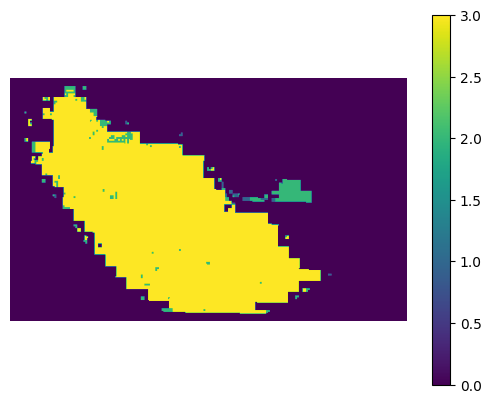

In [19]:
plt.figure()
plt.imshow(categories, cmap='viridis')
plt.axis('off')
plt.colorbar()
plt.show()

In [20]:
# Count the occurrences of each category
category_counts = np.bincount(categorized_pixels, minlength=len(reference_colors))
# Print the counts for each reference color
for i, count in enumerate(category_counts):
    print(f'Reference color {i} (RGB: {reference_colors[i]}): {count} pixels')

Reference color 0 (RGB: [ 1  4 42]): 8 pixels
Reference color 1 (RGB: [  0 106  78]): 172 pixels
Reference color 2 (RGB: [124 250   0]): 1802 pixels
Reference color 3 (RGB: [241 215  27]): 37033 pixels
Reference color 4 (RGB: [255   0   0]): 0 pixels


In [21]:
def analyze_chl_image(image):
    reference_colors = np.array([
    [1, 4, 42],    # Very dark blue
    [0, 106, 78],  # Dark teal
    [124, 250, 0], # Bright yellow-green
    [241, 215, 27],# Mustard yellow
    [255, 0, 0]    # Pure red
    ])

    white_pixels_mask = np.all(image[:, :, :3] == [255, 255, 255], axis=-1)
    black_pixels_mask = np.all(image[:, :, :3] == [0, 0, 0], axis=-1)

    non_black_or_white_mask = ~white_pixels_mask & ~black_pixels_mask
    
    non_black_or_white_pixels = image[non_black_or_white_mask]
    non_black_or_white_pixels = non_black_or_white_pixels.reshape(-1, image.shape[2])

    categorized_pixels = [categorize_pixel(pixel, reference_colors) for pixel in non_black_or_white_pixels]
    category_counts = np.bincount(categorized_pixels, minlength=len(reference_colors))
    
    return category_counts

    

In [22]:
print(analyze_chl_image(chl2))

[    8   172  1802 37033     0]


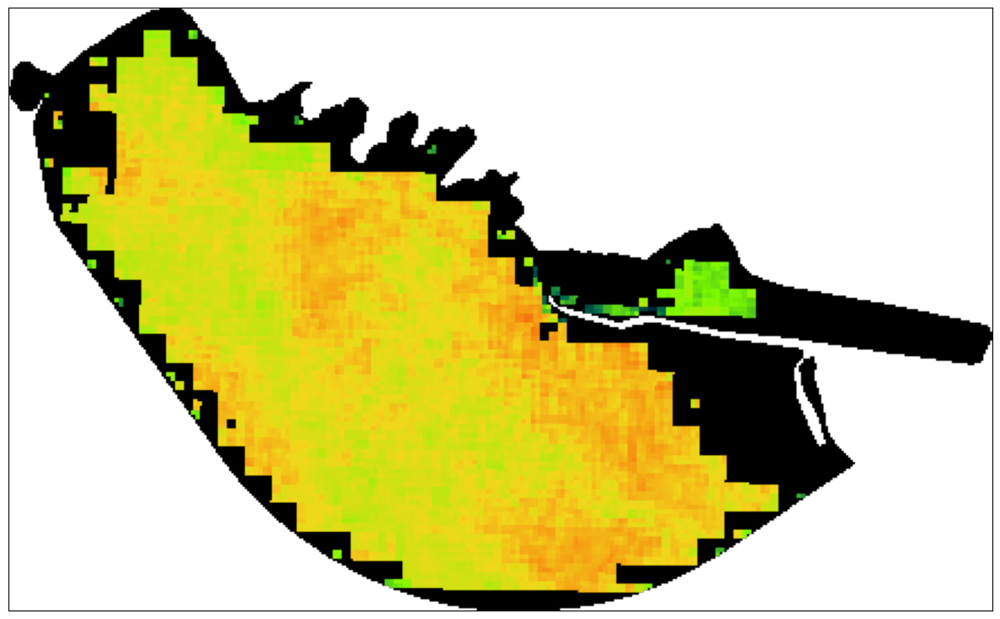

In [23]:
utils.plot_image(chl2)

In [80]:
ndwi = utils.get_image_from_lake(8421510, 'water', datetime(2020, 6, 23), config)
true = utils.get_image_from_lake(8421510, 'true', datetime(2020, 6, 23), config)
cloud = utils.get_image_from_lake(8421510, 'cloud', datetime(2020, 6, 23), config)
chl = utils.get_image_from_lake(8421510, 'chl', datetime(2020, 6, 23), config)

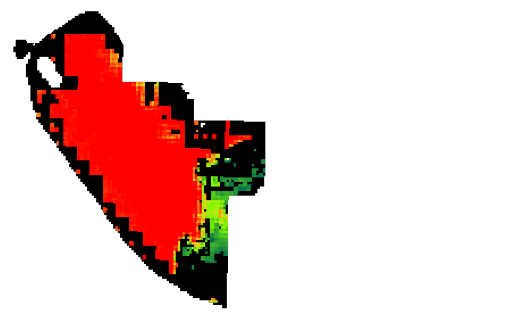

In [25]:
water_mask = ((ndwi[:, :, 2] > ndwi[:, :, 0])
        & (ndwi[:, :, 2] > ndwi[:, :, 1])
        & (ndwi[:, :, 3] != 0))

cloud_mask = (
        (cloud[:, :, 0] > cloud[:, :, 1])
        & (cloud[:, :, 0] > cloud[:, :, 2])
        & (cloud[:, :, 0] > 190)
    )

water_no_cloud_mask = water_mask & ~cloud_mask

water_no_cloud_count = np.sum(water_no_cloud_mask)

water_no_cloud_region = np.zeros_like(chl)
water_no_cloud_region[water_no_cloud_mask] = chl[water_no_cloud_mask]

plt.figure()
plt.imshow(water_no_cloud_region)
plt.axis('off')
plt.show()



In [26]:
water_no_cloud_count

27729

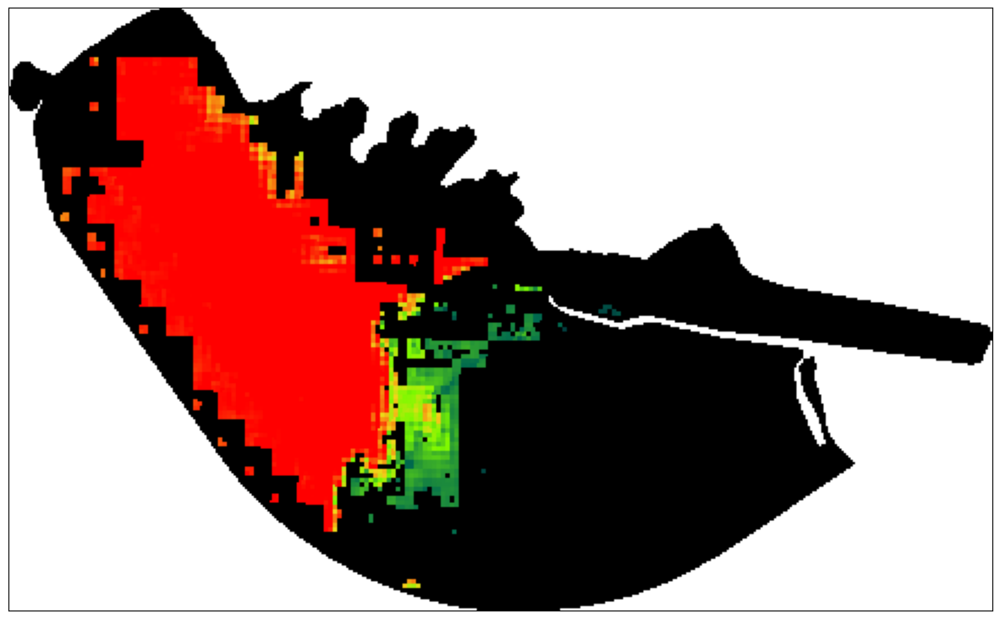

In [131]:
utils.plot_image(chl)

In [27]:
print(utils.analyze_chl_image(water_no_cloud_region))

[    0   897   769   719 14619]


In [31]:
log, images = utils.get_lake_log(8421510, datetime(2020, 6, 23), config)

In [32]:
log

{'osmid': 8421510,
 'day': '2020-06-23',
 'is_valid': True,
 'water_pixels': 37850,
 'cloud_pixels': 27338,
 'water_with_no_clouds_pixels': 27729,
 'chl_very_low_pixels': 10725,
 'chl_low_pixels': 897,
 'chl_moderate_pixels': 769,
 'chl_high_pixels': 719,
 'chl_very_high_pixels': 14619}

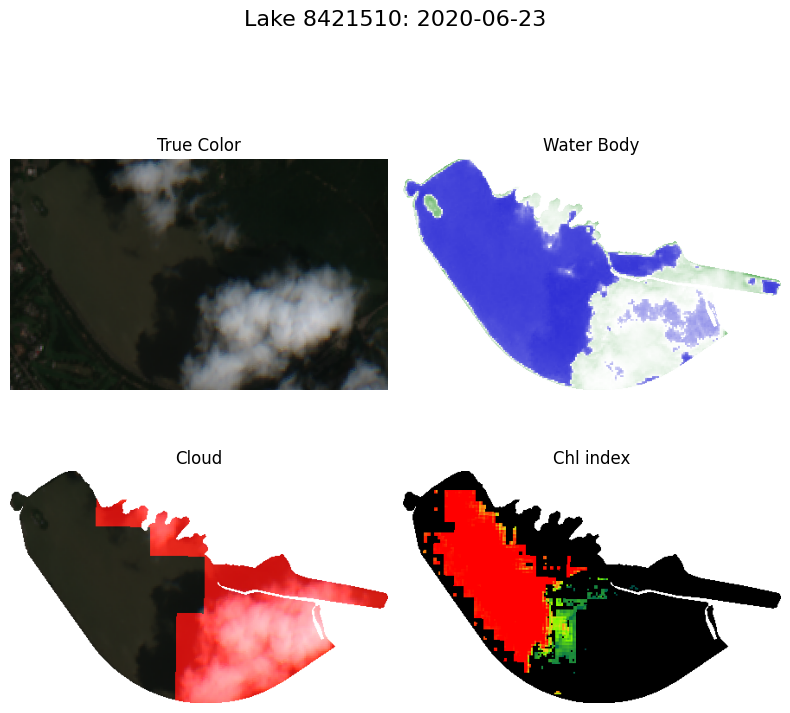

In [34]:
utils.plot_all_type_images(8421510, datetime(2020, 6, 23), images)

In [85]:
logs, images = utils.get_historical_lake_log(8421510, datetime(2020, 1, 1), datetime(2021, 1, 1), config)

In [38]:
logs

,osmid,day,is_valid,water_pixels,cloud_pixels,water_with_no_clouds_pixels,chl_very_low_pixels,chl_low_pixels,chl_moderate_pixels,chl_high_pixels,chl_very_high_pixels
0,8421510,2020-01-05,True,53027.0,0.0,53027.0,11688.0,933.0,12910.0,27496.0,0.0
1,8421510,2020-01-10,True,52937.0,0.0,52937.0,10847.0,1492.0,2893.0,37705.0,0.0
2,8421510,2020-01-15,True,56282.0,56636.0,0.0,0.0,0.0,0.0,0.0,0.0
3,8421510,2020-01-20,True,53154.0,0.0,53154.0,41773.0,754.0,5683.0,4944.0,0.0
4,8421510,2020-01-25,True,54134.0,27104.0,29223.0,6418.0,341.0,13336.0,9128.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
68,8421510,2020-12-10,True,48875.0,0.0,48875.0,10077.0,41.0,945.0,29026.0,8786.0
69,8421510,2020-12-15,True,48502.0,1755.0,47249.0,22044.0,8.0,165.0,24926.0,106.0
70,8421510,2020-12-20,True,51309.0,53.0,51295.0,16862.0,90.0,393.0,33234.0,716.0
71,8421510,2020-12-25,True,51695.0,0.0,51695.0,14887.0,57.0,785.0,35966.0,0.0


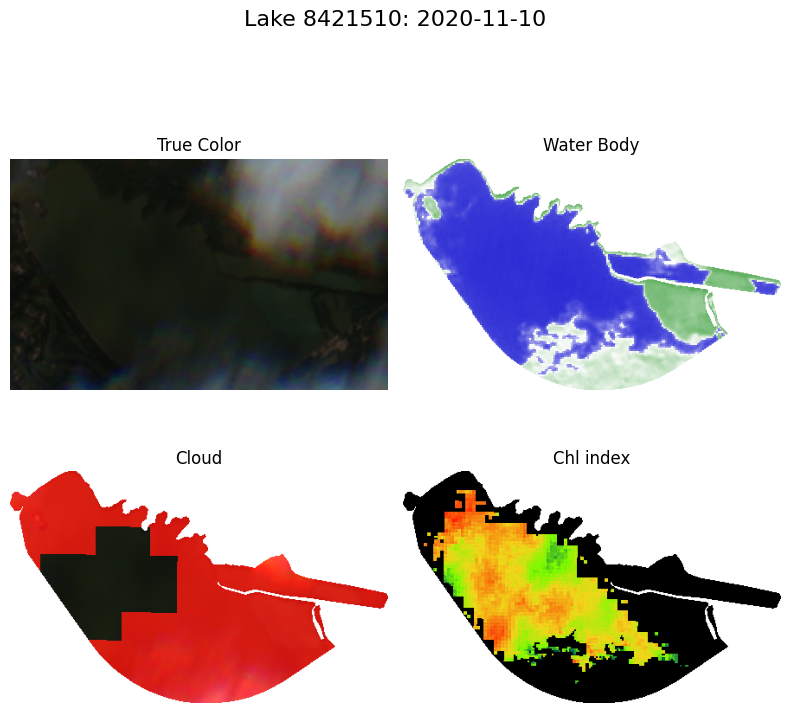

In [86]:
utils.plot_all_type_images(8421510, datetime(2020, 11, 10),images["2020-11-10"])

In [52]:
log, imagenes = utils.get_lake_log(8421510, datetime(2020, 5, 29), config)

In [53]:
log

{'osmid': 8421510, 'day': '2020-05-29', 'is_valid': False}

In [56]:
utils.plot_log(8421510, datetime(2020, 5, 29), imagenes, log)

In [46]:
images.keys()

dict_keys(['2020-01-05', '2020-01-10', '2020-01-15', '2020-01-20', '2020-01-25', '2020-01-30', '2020-02-04', '2020-02-09', '2020-02-14', '2020-02-19', '2020-02-24', '2020-02-29', '2020-03-05', '2020-03-10', '2020-03-15', '2020-03-20', '2020-03-25', '2020-03-30', '2020-04-04', '2020-04-09', '2020-04-14', '2020-04-19', '2020-04-24', '2020-04-29', '2020-05-04', '2020-05-09', '2020-05-14', '2020-05-19', '2020-05-24', '2020-05-29', '2020-06-03', '2020-06-08', '2020-06-13', '2020-06-18', '2020-06-23', '2020-06-28', '2020-07-03', '2020-07-08', '2020-07-13', '2020-07-18', '2020-07-23', '2020-07-28', '2020-08-02', '2020-08-07', '2020-08-12', '2020-08-17', '2020-08-22', '2020-08-27', '2020-09-01', '2020-09-06', '2020-09-11', '2020-09-16', '2020-09-21', '2020-09-26', '2020-10-01', '2020-10-06', '2020-10-11', '2020-10-16', '2020-10-21', '2020-10-26', '2020-10-31', '2020-11-05', '2020-11-10', '2020-11-15', '2020-11-20', '2020-11-25', '2020-11-30', '2020-12-05', '2020-12-10', '2020-12-15', '2020-12-

In [50]:
logs['day'].unique()

array(['2020-01-05', '2020-01-10', '2020-01-15', '2020-01-20',
       '2020-01-25', '2020-01-30', '2020-02-04', '2020-02-09',
       '2020-02-14', '2020-02-19', '2020-02-24', '2020-02-29',
       '2020-03-05', '2020-03-10', '2020-03-15', '2020-03-20',
       '2020-03-25', '2020-03-30', '2020-04-04', '2020-04-09',
       '2020-04-14', '2020-04-19', '2020-04-24', '2020-04-29',
       '2020-05-04', '2020-05-09', '2020-05-14',
       datetime.datetime(2020, 5, 19, 0, 0), '2020-05-24',
       datetime.datetime(2020, 5, 29, 0, 0), '2020-06-03', '2020-06-08',
       '2020-06-13', '2020-06-18', '2020-06-23', '2020-06-28',
       '2020-07-03', '2020-07-08', '2020-07-13', '2020-07-18',
       '2020-07-23', '2020-07-28', '2020-08-02', '2020-08-07',
       '2020-08-12', '2020-08-17', '2020-08-22', '2020-08-27',
       '2020-09-01', '2020-09-06', '2020-09-11', '2020-09-16',
       '2020-09-21', '2020-09-26', '2020-10-01', '2020-10-06',
       '2020-10-11', '2020-10-16', '2020-10-21', '2020-10-26',


In [49]:
logs[logs['day'] == '2020-05-14']

,osmid,day,is_valid,water_pixels,cloud_pixels,water_with_no_clouds_pixels,chl_very_low_pixels,chl_low_pixels,chl_moderate_pixels,chl_high_pixels,chl_very_high_pixels
26,8421510,2020-05-14,True,175.0,56636.0,0.0,0.0,0.0,0.0,0.0,0.0


c:\Users\agand\OneDrive\Escritorio\lakes\lake-algae-analysis\notebooks\utils.py:637: UserWarning: The figure layout has changed to tight


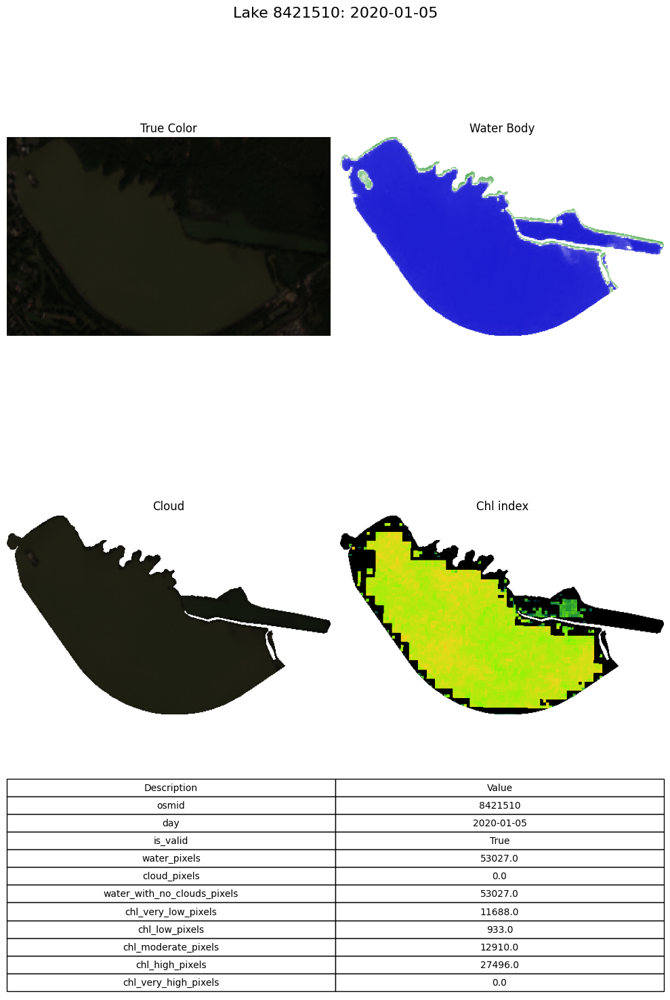

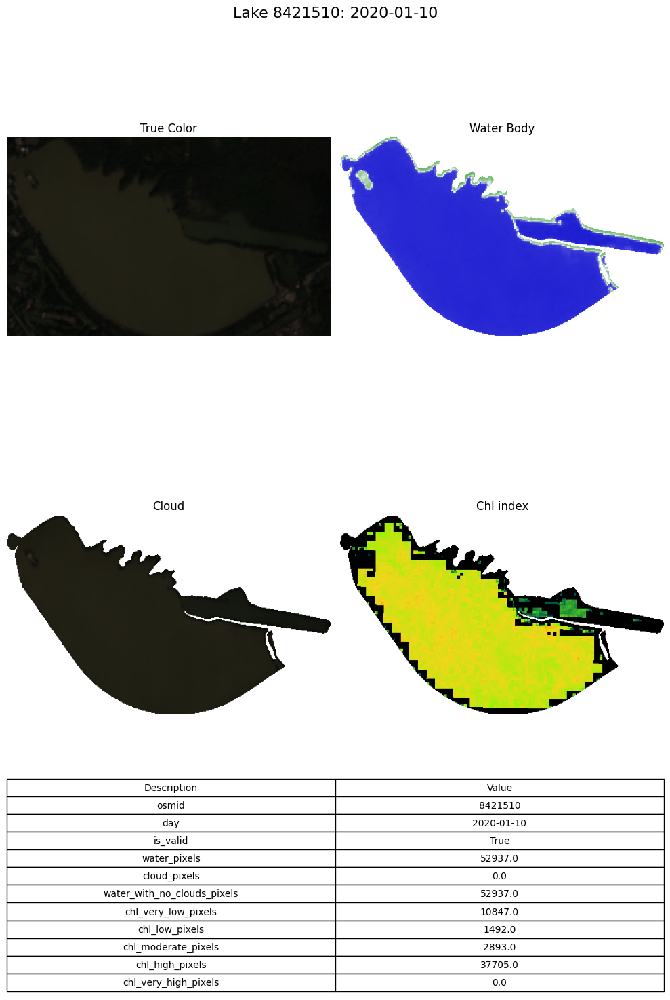

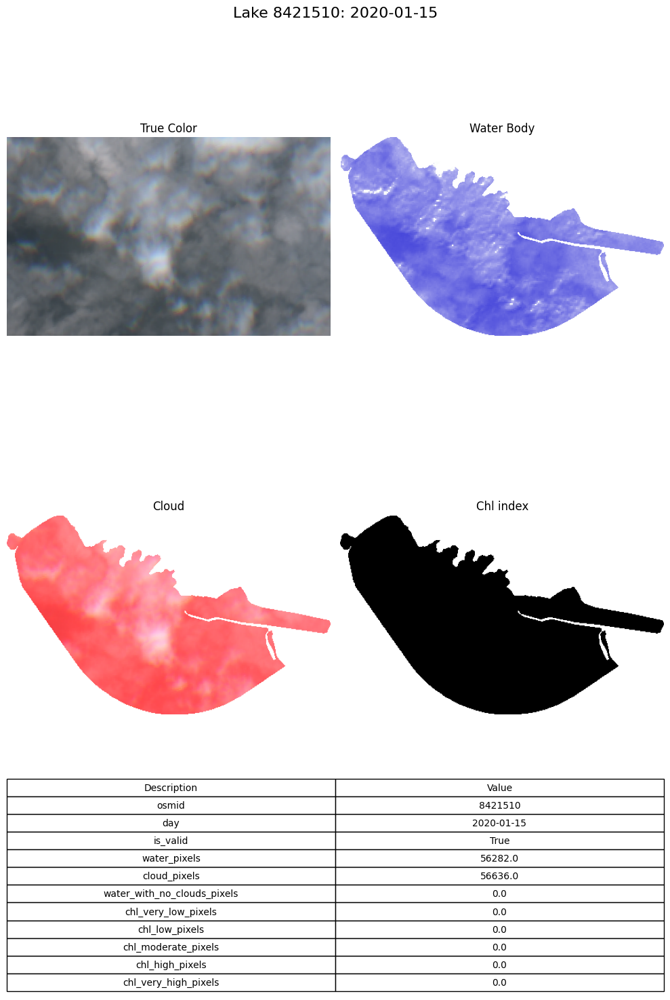

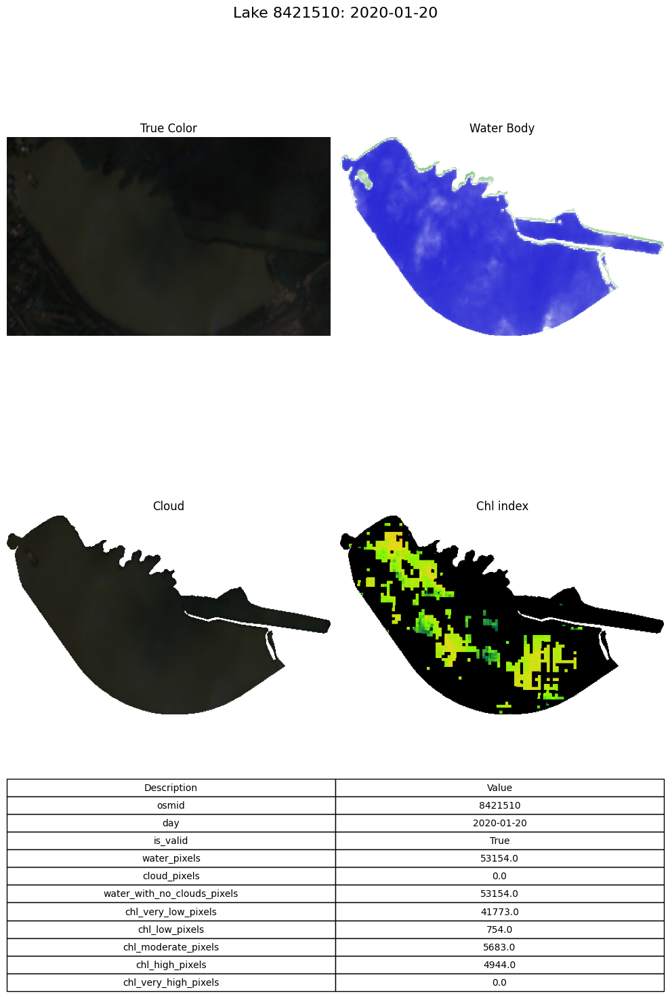

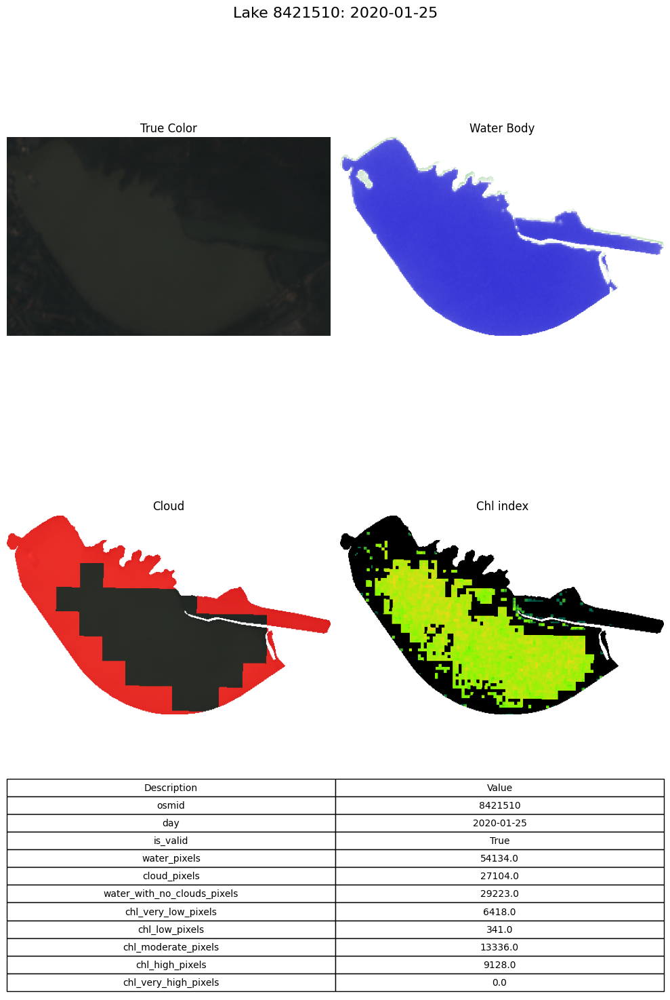

...

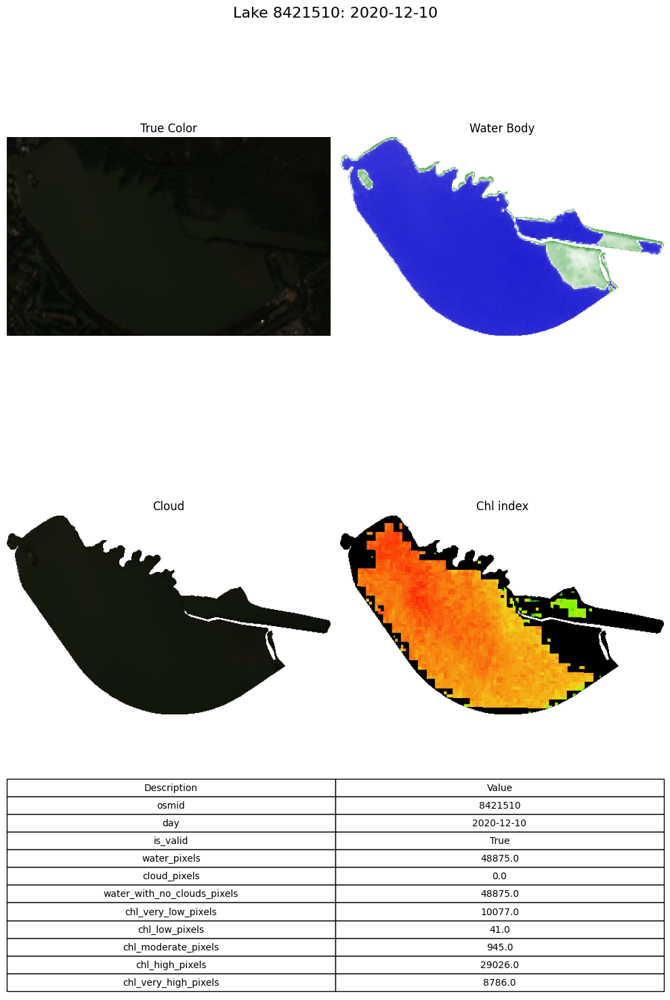

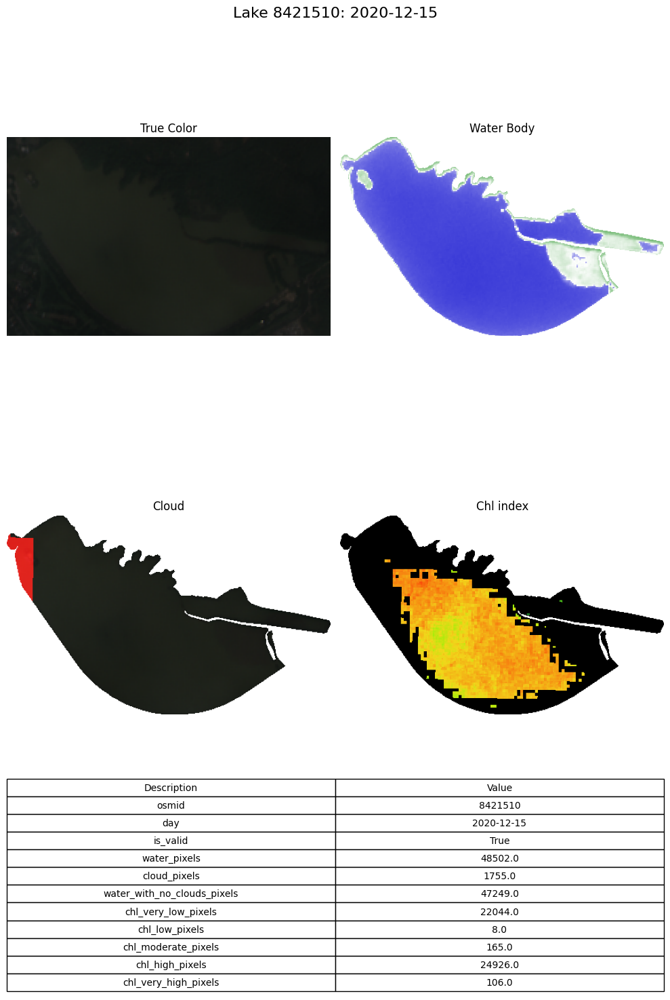

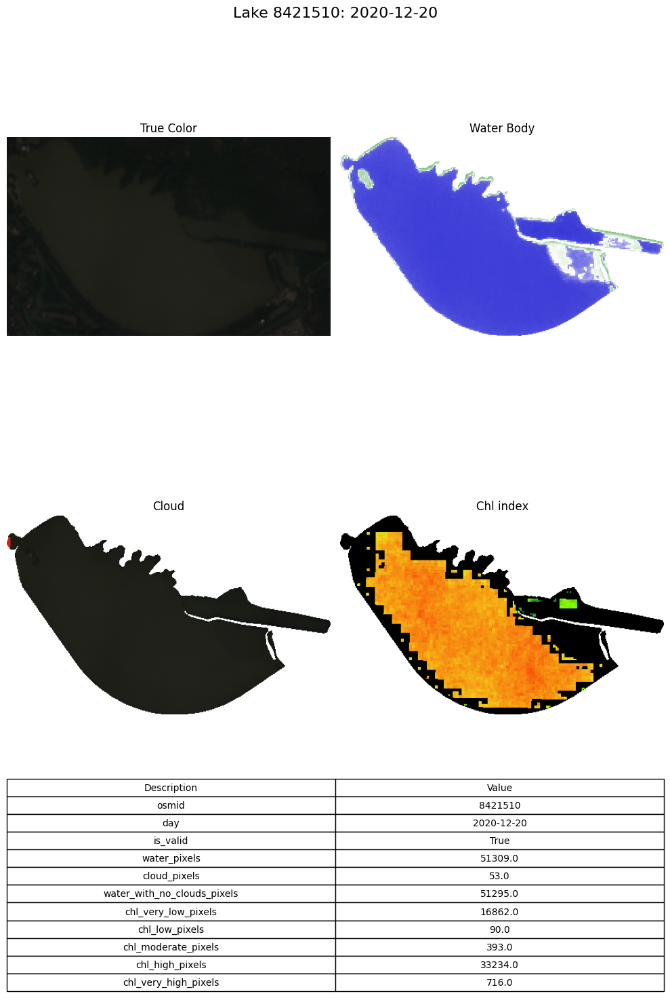

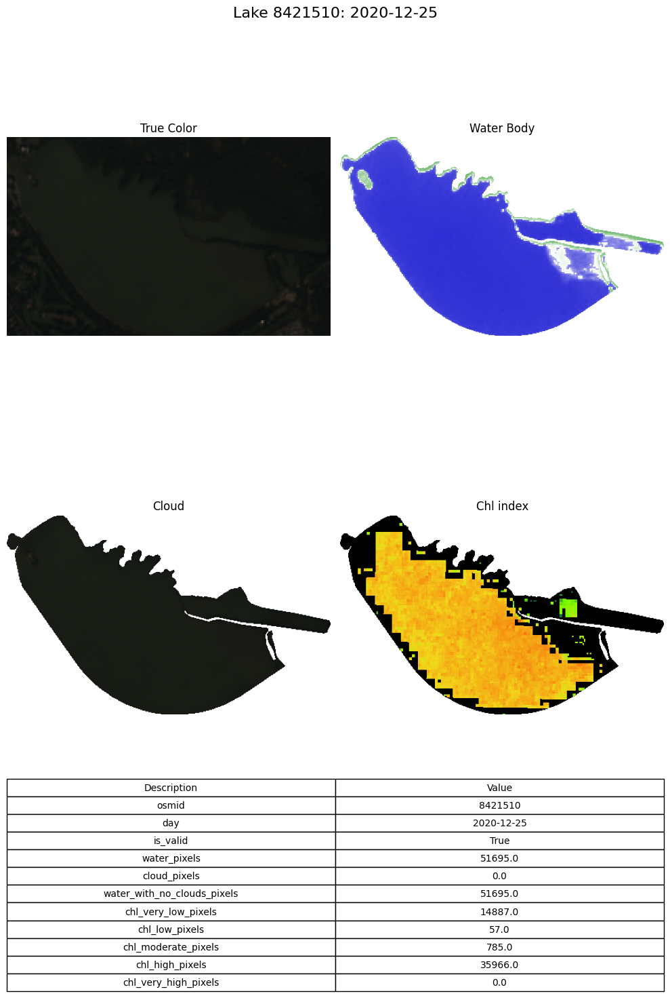

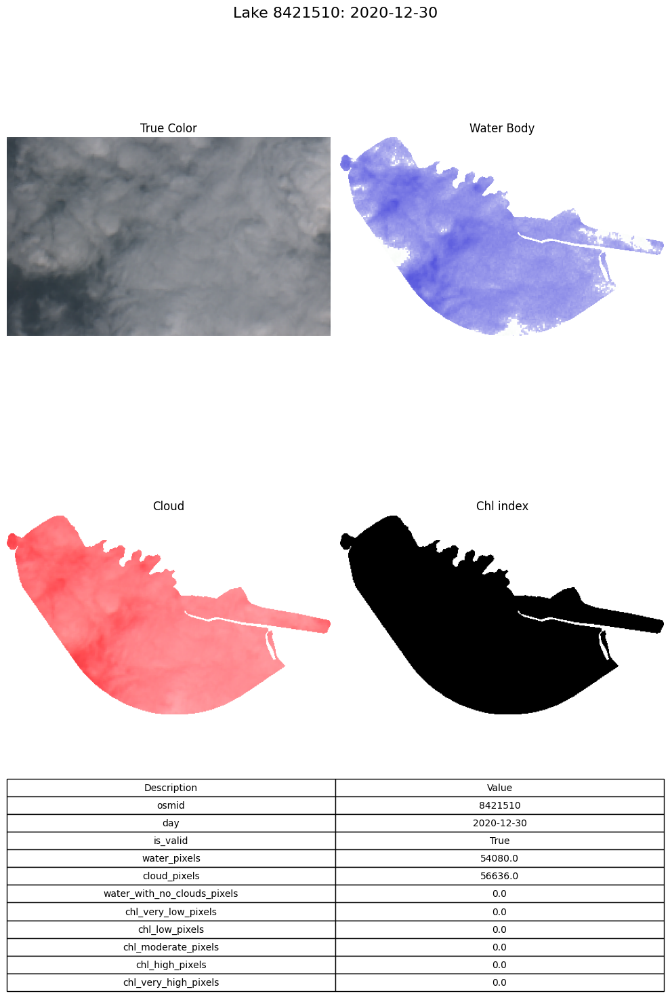

In [89]:
for index, row in logs.iterrows():
    osmid = row['osmid']
    date_str = row['day']
    date = pd.to_datetime(date_str)
    day_images = images[date_str]
    utils.plot_log(osmid, date, day_images, row)



In [20]:
log, images = utils.get_historical_lake_log(145541908, datetime(2020, 6, 1), datetime(2023, 6, 1),12, config)

c:\Users\agand\OneDrive\Escritorio\lakes\lake-algae-analysis\notebooks\utils.py:637: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


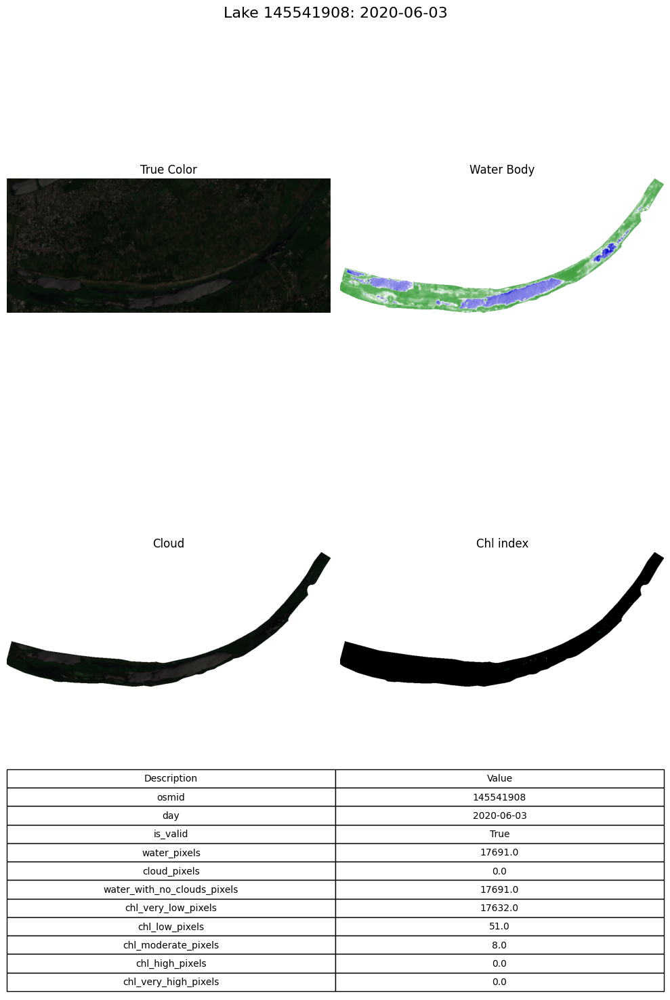

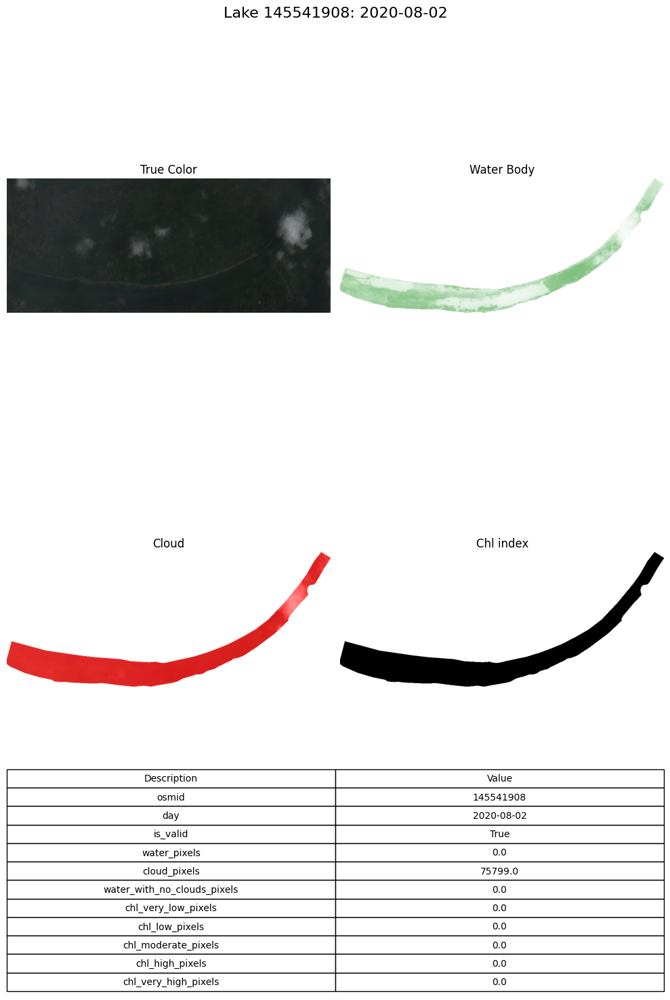

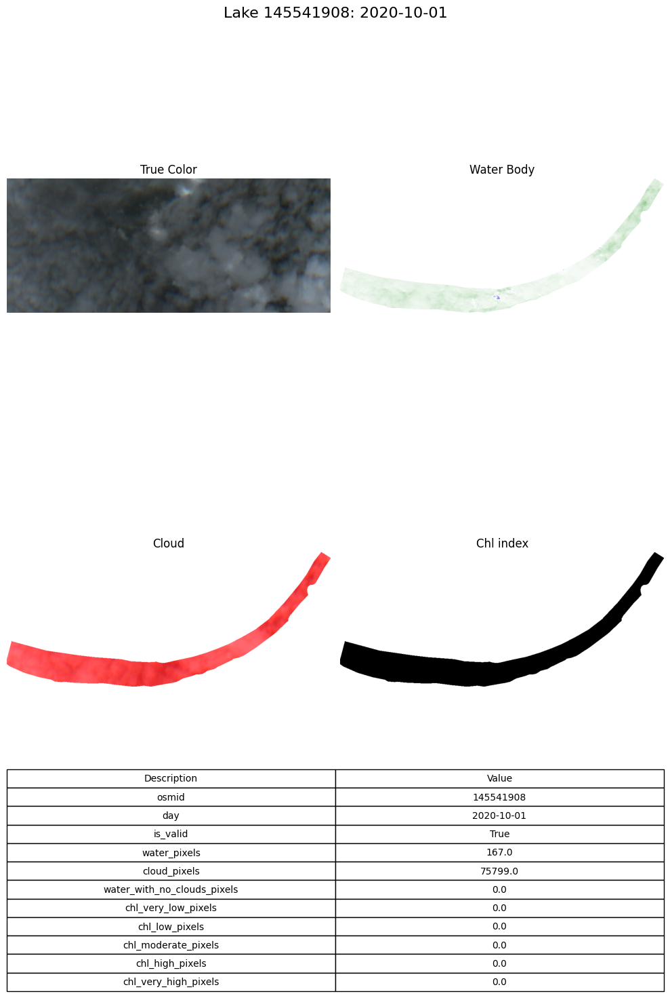

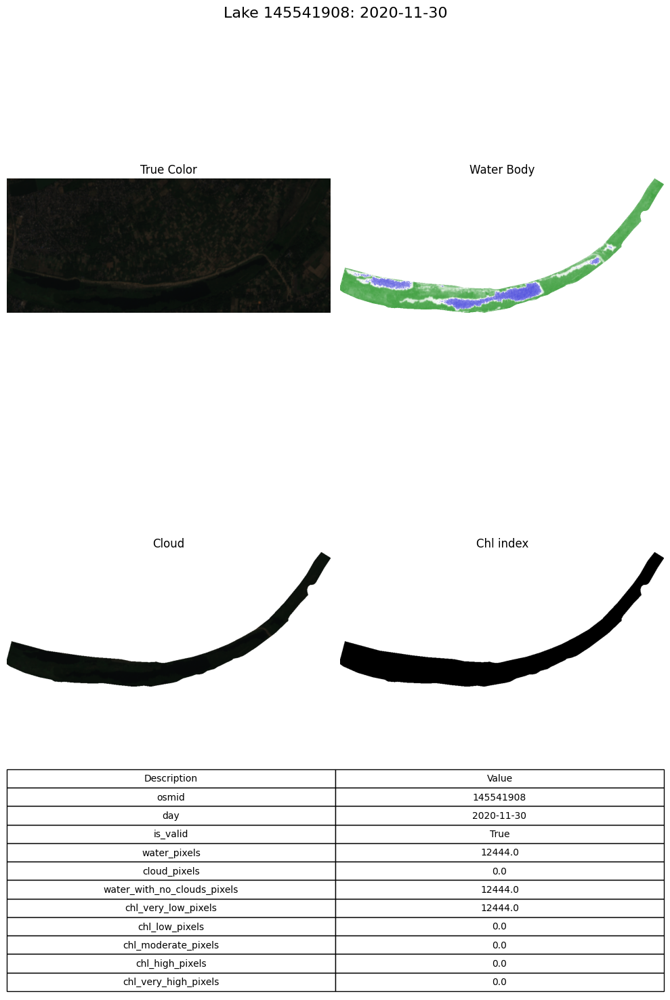

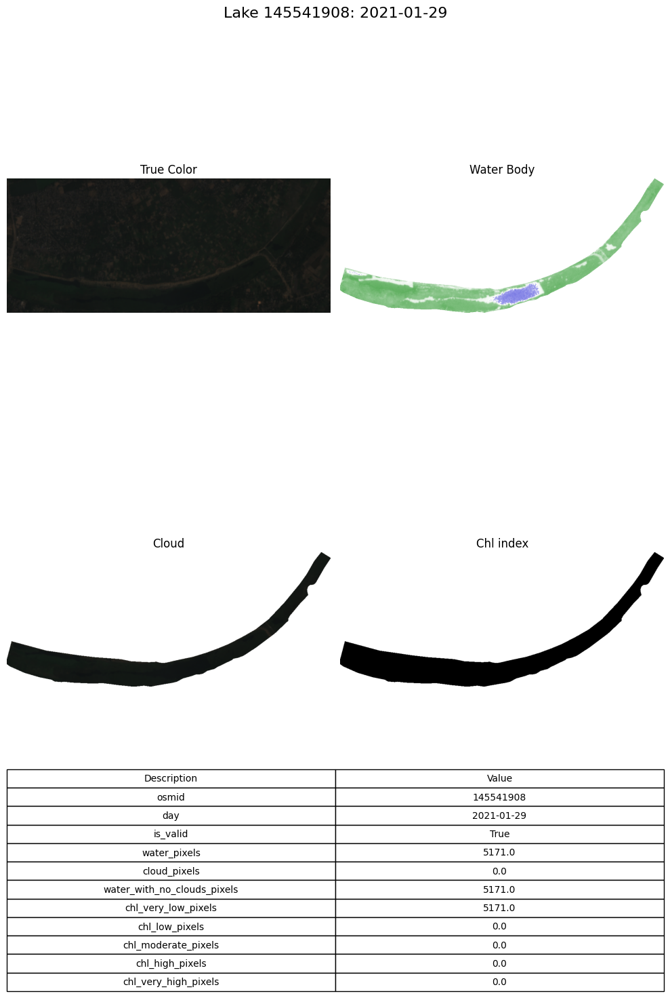

...

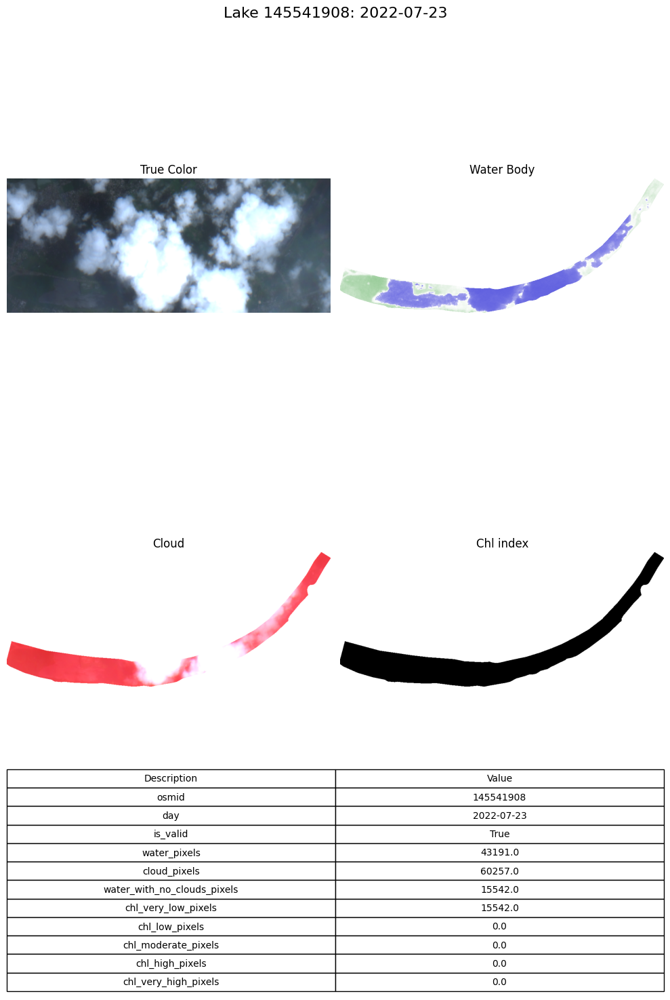

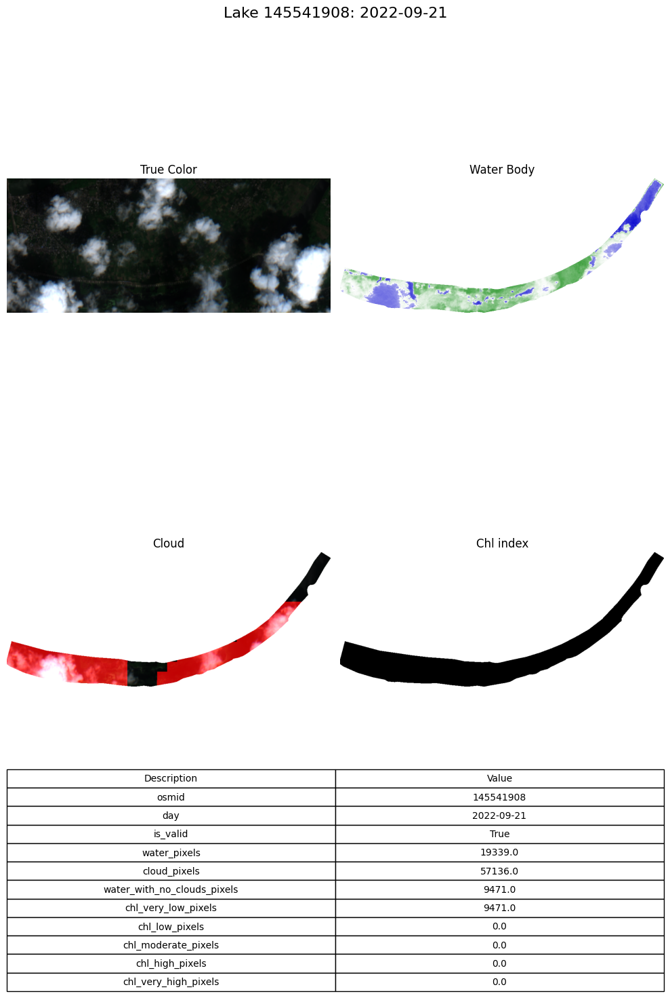

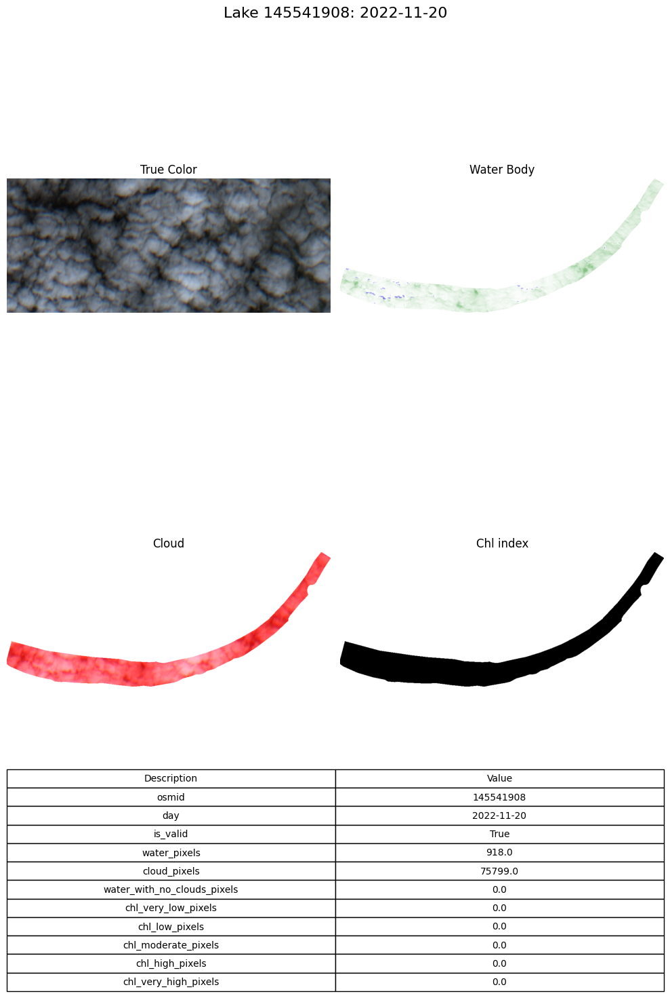

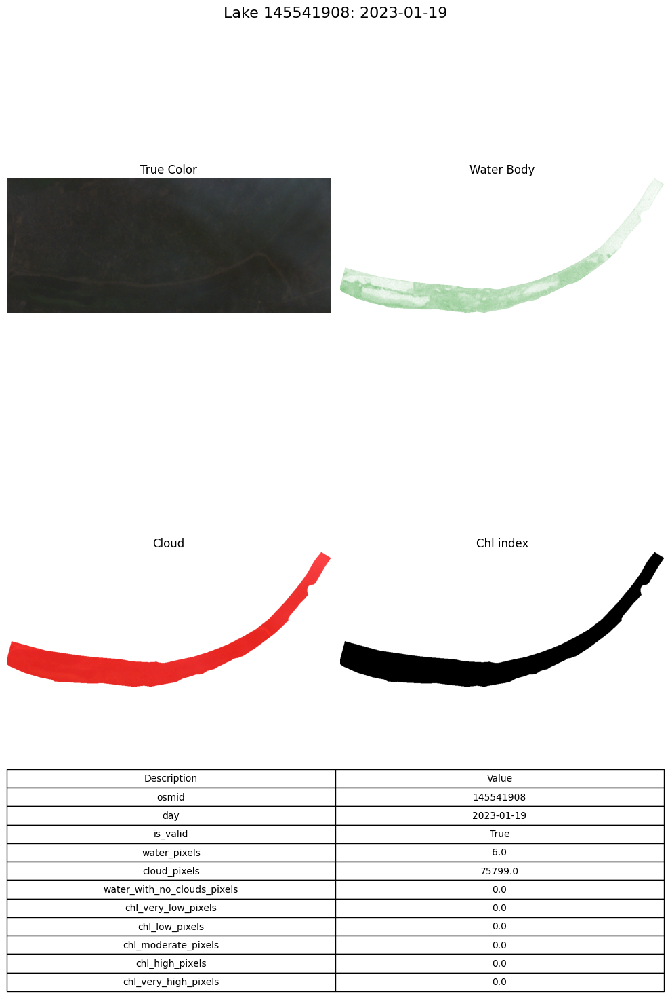

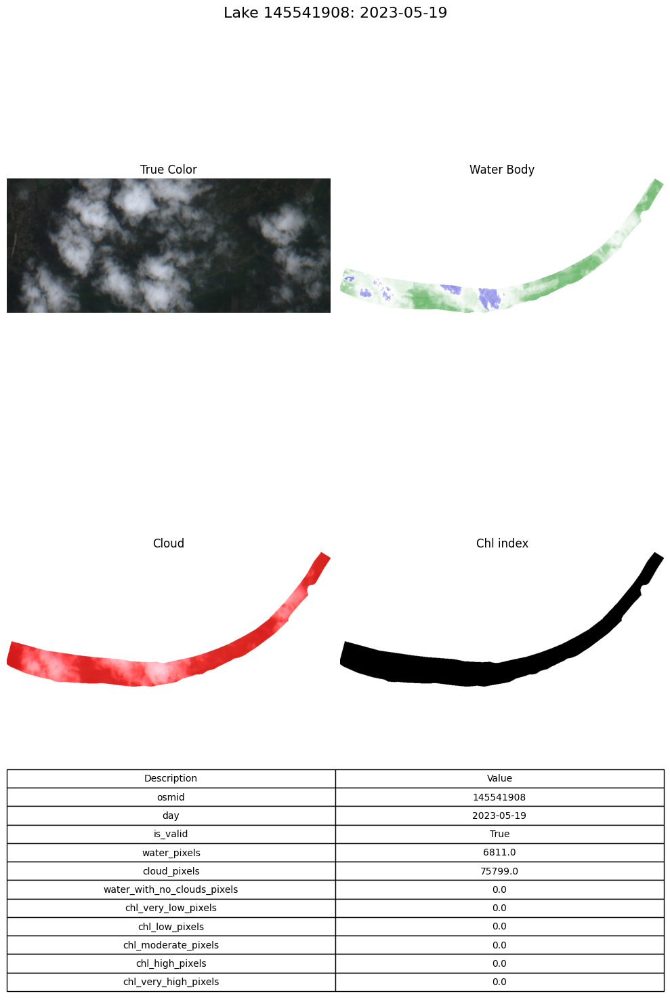

In [21]:
utils.plot_historical_lake_logs(log, images)

In [14]:
log, images = utils.get_lake_log(8421510, datetime(2020, 6, 23))

In [15]:
true = images[0]

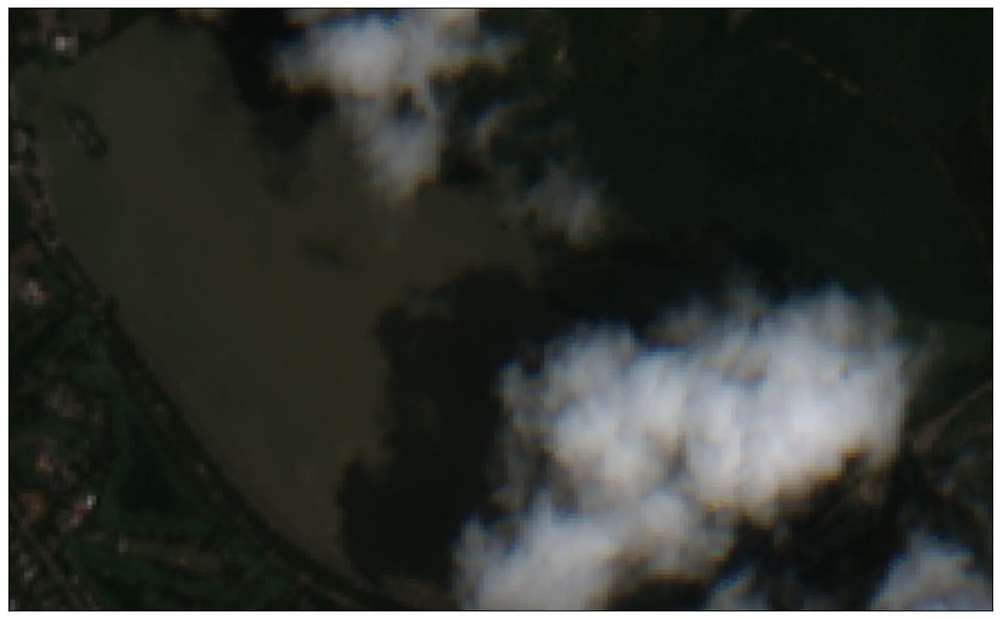

In [16]:
utils.plot_image(true)

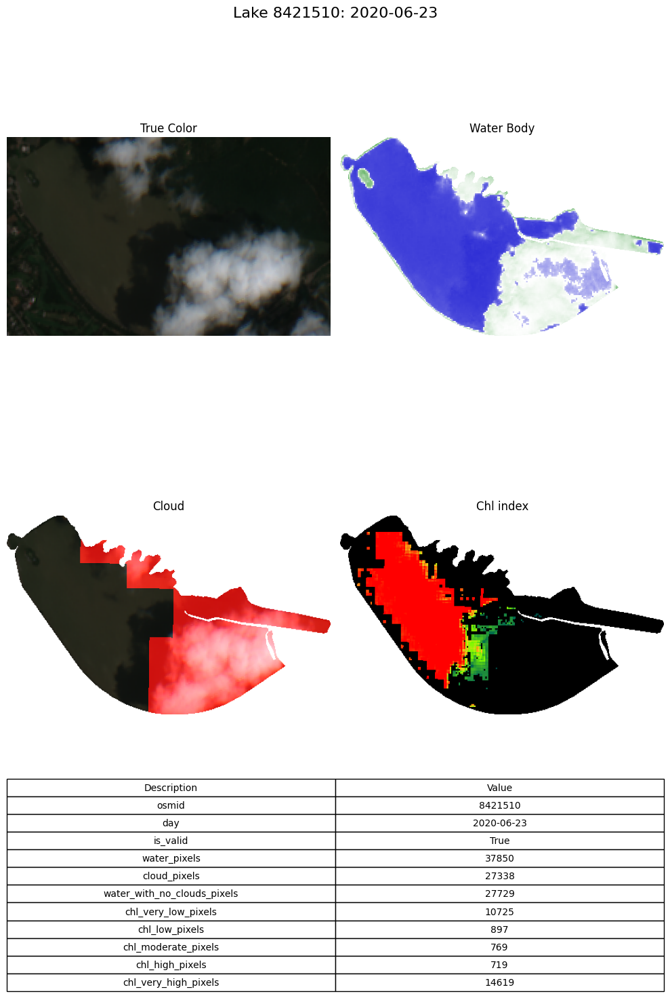

In [26]:
utils.plot_log(log, images)

In [38]:
water = images[1]

In [39]:
white_mask = np.all(water[:, :, :3] == [255, 255, 255], axis=-1)
non_white_mask = ~white_mask
print(np.sum(non_white_mask))

56508


array([[[255, 255, 255,   0],
        [255, 255, 255,   0],
        [255, 255, 255,   0],
        ...,
        [255, 255, 255,   0],
        [255, 255, 255,   0],
        [255, 255, 255,   0]],

       [[255, 255, 255,   0],
        [255, 255, 255,   0],
        [255, 255, 255,   0],
        ...,
        [255, 255, 255,   0],
        [255, 255, 255,   0],
        [255, 255, 255,   0]],

       [[255, 255, 255,   0],
        [255, 255, 255,   0],
        [255, 255, 255,   0],
        ...,
        [255, 255, 255,   0],
        [255, 255, 255,   0],
        [255, 255, 255,   0]],

       ...,

       [[255, 255, 255,   0],
        [255, 255, 255,   0],
        [255, 255, 255,   0],
        ...,
        [255, 255, 255,   0],
        [255, 255, 255,   0],
        [255, 255, 255,   0]],

       [[255, 255, 255,   0],
        [255, 255, 255,   0],
        [255, 255, 255,   0],
        ...,
        [255, 255, 255,   0],
        [255, 255, 255,   0],
        [255, 255, 255,   0]],

       [[255

In [40]:
size_image = utils.get_image_from_lake(8421510, "chl", datetime(2020,3 ,15 ))

El polígono del lago abarca un total de 55657 píxeles.


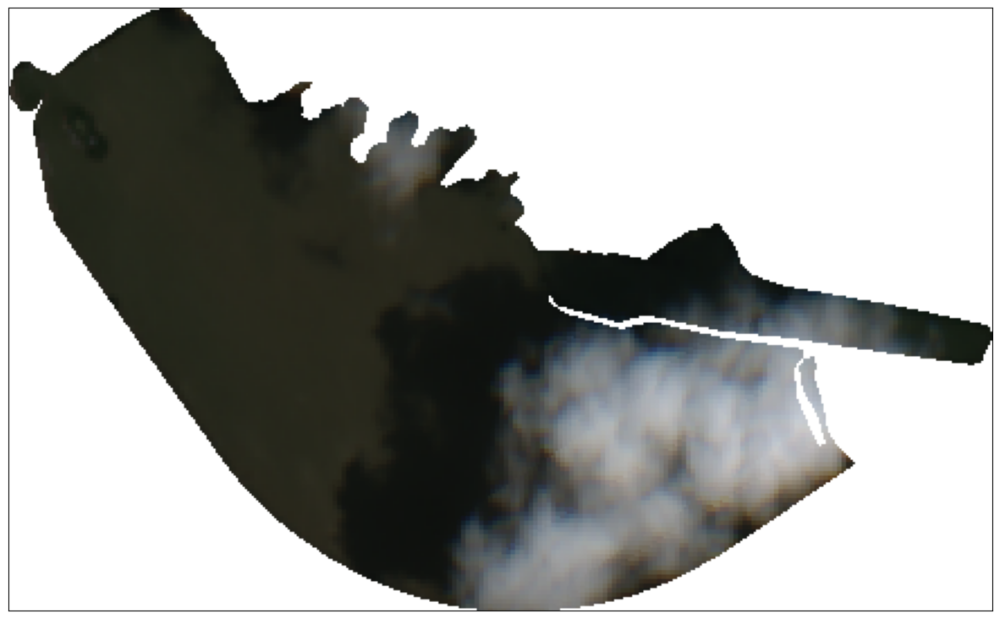

In [31]:
utils.plot_image(size_image)

In [32]:
size_image

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

In [33]:
white_mask = np.all(size_image[:, :, :3] == [255, 255, 255], axis=-1)
non_white_mask = ~white_mask
print(np.sum(non_white_mask))

56636
